In [1]:
import sys
import stlearn as st
st.settings.set_figure_params(dpi=300)
from pathlib import Path
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
import sys
file = Path("../stimage").resolve()
parent= file.parent
sys.path.append(str(parent))
from PIL import Image
from stimage.utils import gene_plot, Read10X, ReadOldST
from stimage.model import CNN_NB_trainable
from stimage.data_generator import DataGenerator
import tensorflow as tf
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
import numpy as np

In [2]:
BASE_PATH = Path("/clusterdata/uqxtan9/Xiao/STimage/dataset/breast_cancer_10x_visium")
TILE_PATH = Path("/tmp") / "tiles"
TILE_PATH.mkdir(parents=True, exist_ok=True)

SAMPLE = "block1"
Sample1 = st.Read10X(BASE_PATH / SAMPLE, 
                  library_id=SAMPLE, 
                  count_file="V1_Breast_Cancer_Block_A_Section_1_filtered_feature_bc_matrix.h5",
                  quality="fulres",)
                  #source_image_path=BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_1_image.tif")
img = plt.imread(BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_1_image.tif", 0)
Sample1.uns["spatial"][SAMPLE]['images']["fulres"] = img

SAMPLE = "block2"
Sample2 = st.Read10X(BASE_PATH / SAMPLE, 
                  library_id=SAMPLE, 
                  count_file="V1_Breast_Cancer_Block_A_Section_2_filtered_feature_bc_matrix.h5",
                  quality="fulres",)
                  #source_image_path=BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_1_image.tif")
img = plt.imread(BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_2_image.tif", 0)
Sample2.uns["spatial"][SAMPLE]['images']["fulres"] = img

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [3]:
for adata in [
    Sample1,
    Sample2,
]:
#     count_df = adata.to_df()
#     count_df[count_df <=1] = 0
#     count_df[count_df >1] = 1
#     adata.X = count_df
#     adata[:,gene_list]
#     st.pp.filter_genes(adata,min_cells=3)
#     st.pp.normalize_total(adata)
    st.pp.log1p(adata)
#     st.pp.scale(adata)

    # pre-processing for spot image
    TILE_PATH_ = TILE_PATH / list(adata.uns["spatial"].keys())[0]
    TILE_PATH_.mkdir(parents=True, exist_ok=True)
    st.pp.tiling(adata, TILE_PATH_, crop_size=299)

Log transformation step is finished in adata.X


Tiling image: 100%|██████████ [ time left: 00:00 ]


Log transformation step is finished in adata.X


Tiling image: 100%|██████████ [ time left: 00:00 ]


In [4]:
m_s1_250 = Sample1.to_df().mean(axis=0).sort_values(ascending=False)[:2]

In [5]:
m_s1_250.index

Index(['COX6C', 'RPL41'], dtype='object')

In [6]:
Sample2.var_names

Index(['MIR1302-2HG', 'FAM138A', 'OR4F5', 'AL627309.1', 'AL627309.3',
       'AL627309.2', 'AL627309.5', 'AL627309.4', 'AP006222.2', 'AL732372.1',
       ...
       'AC133551.1', 'AC136612.1', 'AC136616.1', 'AC136616.3', 'AC136616.2',
       'AC141272.1', 'AC023491.2', 'AC007325.1', 'AC007325.4', 'AC007325.2'],
      dtype='object', length=36601)

In [7]:
comm_genes = m_s1_250.index.intersection(Sample2.var_names)

In [8]:
comm_genes

Index(['COX6C', 'RPL41'], dtype='object')

In [4]:
comm_genes=["SLITRK6", "PGM5", "LINC00645", 
           "TTLL12", "COX6C", "CPB1",
           "KRT5", "MALAT1"]

In [5]:
Sample1 = Sample1[:,comm_genes]
Sample2 = Sample2[:,comm_genes]

In [9]:
# training_index = Sample1.obs.sample(frac=0.9, random_state=1).index
# training_dataset = Sample1[training_index,].copy()

training_dataset = Sample1.copy()

# valid_index = Sample1.obs.index.isin(training_index)
# valid_dataset = Sample1[~valid_index,].copy()

test_dataset = Sample2.copy()

train_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator(adata=training_dataset, 
                          genes=comm_genes, aug=True),
            output_types=(tf.float32, tuple([tf.float32]*8)), 
            output_shapes=([299,299,3], tuple([1]*8))
)
train_gen_ = train_gen.shuffle(buffer_size=500).batch(128).repeat(3).cache().prefetch(tf.data.experimental.AUTOTUNE)
# valid_gen = tf.data.Dataset.from_generator(
#             lambda:DataGenerator(adata=valid_dataset, 
#                           genes=comm_genes), 
#             output_types=(tf.float32, tuple([tf.float32]*8)), 
#             output_shapes=([299,299,3], tuple([1]*8))
# )
# valid_gen_ = valid_gen.shuffle(buffer_size=500).batch(128).repeat(3).cache().prefetch(tf.data.experimental.AUTOTUNE)
test_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator(adata=test_dataset, 
                          genes=comm_genes), 
            output_types=(tf.float32, tuple([tf.float32]*8)), 
            output_shapes=([299,299,3], tuple([1]*8))
)
test_gen_ = test_gen.batch(1)

In [15]:
for images, labels in train_gen_.take(1):
    print('images.shape: ', images.shape)
    print('labels.shape: ', type(labels[0]))

images.shape:  (128, 299, 299, 3)
labels.shape:  <class 'tensorflow.python.framework.ops.EagerTensor'>


In [18]:
g_means_ = Sample1.to_df().mean(axis=0).values

In [19]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
g_means = scaler.fit_transform(g_means_.reshape(-1,1))


In [44]:
g_means_

array([1.8070037 , 0.38994208, 0.98894155], dtype=float32)

In [45]:
g_means

array([[0.9999999 ],
       [0.        ],
       [0.42270526]], dtype=float32)

In [26]:
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input as preprocess_vgg16
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input as preprocess_resnet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Input, concatenate, Dropout, Lambda, Concatenate
from tensorflow.keras.models import Model
import tensorflow_probability as tfp
tf.compat.v1.enable_eager_execution()
tfd = tfp.distributions
tfb = tfp.bijectors
import six
from tensorflow.python.keras import backend as K
from tensorflow.python.keras.utils.tf_utils import is_tensor_or_variable

def ZINB_layer(out): 
    n = tf.squeeze(tf.math.softplus(out[:,0:1]))

    p = tf.squeeze(tf.math.sigmoid(out[:,1:2]))

    s = tf.math.sigmoid(out[:,2:3])

    probs = tf.concat([1-s, s], axis=1)
    
    mix = tfd.Mixture(
          cat=tfd.Categorical(probs=probs),
          components=[
          tfd.Deterministic(loc=tf.zeros_like(n)),
          tfd.NegativeBinomial(total_count=n, probs=p),
        ])
    return mix


def NLL(y_true, y_hat):
    return -y_hat.log_prob(tf.reshape(y_true,(-1,)))

def NLL0(y_true, y_hat):
    return -y_hat.log_prob(tf.reshape(y_true[:,0],(-1,)))

def NLL1(y_true, y_hat):
    return -y_hat.log_prob(tf.reshape(y_true[:,1],(-1,)))


class MeanMetricWrapper(tf.keras.metrics.Mean):
    def __init__(self, fn, name=None, dtype=None, **kwargs):
        super(MeanMetricWrapper, self).__init__(name=name, dtype=dtype)
        self._fn = fn
        self._fn_kwargs = kwargs
    def update_state(self, y_true, y_pred, sample_weight=None):
        matches = self._fn(y_true, y_pred, **self._fn_kwargs)
        return super(MeanMetricWrapper, self).update_state(
                     matches, sample_weight=sample_weight)
    def get_config(self):
        config = {}
        for k, v in six.iteritems(self._fn_kwargs):
            config[k] = K.eval(v) if is_tensor_or_variable(v) else v
        base_config = super(MeanMetricWrapper, self).get_config()
        return dict(list(base_config.items()) + list(config.items()))


def one_gene_block(inputs, name):
#     inputs = Dense(256, activation='relu', activity_regularizer=tf.keras.regularizers.l2(0.01))(inputs)
    outputs = Dense(3)(inputs)
    p_y_zinb = tfp.layers.DistributionLambda(ZINB_layer, name=name)(outputs)
    return p_y_zinb



def resnet_ZINB(tile_shape):
    tile_input = Input(shape=tile_shape, name = "tile_input")
    resnet_base = ResNet50(input_tensor=tile_input, weights='imagenet', include_top=False)
    stage_5_start = resnet_base.get_layer("conv5_block1_1_conv")
    for i in range(resnet_base.layers.index(stage_5_start)):
        resnet_base.layers[i].trainable = False
    
    cnn = resnet_base.output
    cnn = GlobalAveragePooling2D()(cnn)
    cnn = Dropout(0.5)(cnn)
    cnn = Dense(512, activation='relu', kernel_regularizer=tf.keras.regularizers.l1(0.01),
                activity_regularizer=tf.keras.regularizers.l2(0.01))(cnn)
    # cnn = Dense(256, activation='relu')(cnn)
    output_layers = []
    for i in range(3):
        output_layers.append(one_gene_block(cnn, name="gene_{}".format(i)))

    model = Model(inputs=tile_input, outputs=tf.stack(output_layers))

#     optimizer = tf.keras.optimizers.RMSprop(0.001)
    optimizer = tf.keras.optimizers.Adam(0.001)
#     losses={
#         "gene_0":NLL0,
#         "gene_1":NLL1,
#     }
    model.compile(loss=NLL,
                  optimizer=optimizer,
                  metrics=["accuracy"])    
    return model

In [29]:
def ZINB_layer(out): 
    n = tf.squeeze(tf.math.softplus(out[:,0:1]))

    p = tf.squeeze(tf.math.sigmoid(out[:,1:2]))

    s = tf.math.sigmoid(out[:,2:3])

    probs = tf.concat([1-s, s], axis=1)
    
    mix = tfd.Mixture(
          cat=tfd.Categorical(probs=probs),
          components=[
          tfd.Deterministic(loc=tf.zeros_like(n)),
          tfd.NegativeBinomial(total_count=n, probs=p),
        ])
    return mix

def NLL_gene(y_true, y_hat):
    return -y_hat.log_prob(tf.reshape(y_true,(-1,)))

def resnet_ZINB(tile_shape):
    tile_input = Input(shape=tile_shape, name = "tile_input")
    resnet_base = ResNet50(input_tensor=tile_input, weights='imagenet', include_top=False)
#     stage_5_start = resnet_base.get_layer("conv5_block1_1_conv")
#     for i in range(resnet_base.layers.index(stage_5_start)):
#         resnet_base.layers[i].trainable = False
    
    for i in resnet_base.layers:
        i.trainable = False
    cnn = resnet_base.output
    cnn = GlobalAveragePooling2D()(cnn)
#     cnn = Dropout(0.5)(cnn)
#     cnn = Dense(512, activation='relu', kernel_regularizer=tf.keras.regularizers.l1(0.01),
#                 activity_regularizer=tf.keras.regularizers.l2(0.01))(cnn)
    # cnn = Dense(256, activation='relu')(cnn)
    output_layers = []
    for i in range(8):
        output_layers.append(one_gene_block(cnn, name="gene_{}".format(i)))

    
    
    model = Model(inputs=tile_input, outputs=output_layers)

#     optimizer = tf.keras.optimizers.RMSprop(0.001)
    optimizer = tf.keras.optimizers.Adam(0.0001)
    model.compile(loss=NLL_gene,
                  optimizer=optimizer)    
    return model

In [18]:
def resnet_ZINB(tile_shape):
    tile_input = Input(shape=tile_shape, name = "tile_input")
    resnet_base = ResNet50(input_tensor=tile_input, weights='imagenet', include_top=False)
#     stage_5_start = resnet_base.get_layer("conv5_block1_1_conv")
#     for i in range(resnet_base.layers.index(stage_5_start)):
#         resnet_base.layers[i].trainable = False
    
    for i in resnet_base.layers:
        i.trainable = False
    cnn = resnet_base.output
    cnn = GlobalAveragePooling2D()(cnn)
#     cnn = Dropout(0.5)(cnn)
#     cnn = Dense(512, activation='relu', kernel_regularizer=tf.keras.regularizers.l1(0.01),
#                 activity_regularizer=tf.keras.regularizers.l2(0.01))(cnn)
    # cnn = Dense(256, activation='relu')(cnn)
    cnn = Dense(3*8, activation='relu')(cnn)
    output_layers = []
    for i in range(8):
        output_layers.append(tfp.layers.DistributionLambda(ZINB_layer, 
                                                           name="gene_{}".format(i))(cnn[:,i*3:i*3+3]))

    
    
    model = Model(inputs=tile_input, outputs=output_layers)
    losses={}
    for i in range(8):
        losses["gene_{}".format(i)] = lambda x,y : -y.log_prob((x[:,i]))
#     optimizer = tf.keras.optimizers.RMSprop(0.001)
    optimizer = tf.keras.optimizers.Adam(0.0001)
    model.compile(loss=losses,
                  optimizer=optimizer)    
    return model

In [19]:
def negative_binomial_layer(x):
    """
    Lambda function for generating negative binomial parameters
    n and p from a Dense(2) output.
    Assumes tensorflow 2 backend.

    Usage
    -----
    outputs = Dense(2)(final_layer)
    distribution_outputs = Lambda(negative_binomial_layer)(outputs)

    Parameters
    ----------
    x : tf.Tensor
        output tensor of Dense layer

    Returns
    -------
    out_tensor : tf.Tensor

    """

    # Get the number of dimensions of the input
    num_dims = len(x.get_shape())

    # Separate the parameters
    n, p = tf.unstack(x, num=2, axis=-1)

    # Add one dimension to make the right shape
    n = tf.expand_dims(n, -1)
    p = tf.expand_dims(p, -1)

    # Apply a softplus to make positive
    n = tf.keras.activations.softplus(n)

    # Apply a sigmoid activation to bound between 0 and 1
    p = tf.keras.activations.sigmoid(p)

    # Join back together again
    out_tensor = tf.concat((n, p), axis=num_dims - 1)

    return out_tensor

def multiple_gene_nb_loss(genes):
    def negative_binomial_loss(y_true, y_pred):
        """
        Negative binomial loss function.
        Assumes tensorflow backend.
    
        Parameters
        ----------
        y_true : tf.Tensor
            Ground truth values of predicted variable.
        y_pred : tf.Tensor
            n and p values of predicted distribution.

        Returns
        -------
        nll : tf.Tensor
            Negative log likelihood.
        """

        # Separate the parameters
        n, p = tf.unstack(y_pred, num=2, axis=-1)

        # Add one dimension to make the right shape
        n = tf.expand_dims(n, -1)
        p = tf.expand_dims(p, -1)

        # Calculate the negative log likelihood
        nll = (
            tf.math.lgamma(n)
            + tf.math.lgamma(y_true[:,genes] + 1)
            - tf.math.lgamma(n + y_true[:,genes])
            - n * tf.math.log(p)
            - y_true[:,genes] * tf.math.log(1 - p)
        )

        return nll
    return negative_binomial_loss


def resnet_NB(tile_shape):
    tile_input = Input(shape=tile_shape, name = "tile_input")
    resnet_base = ResNet50(input_tensor=tile_input, weights='imagenet', include_top=False)
#     stage_5_start = resnet_base.get_layer("conv5_block1_1_conv")
#     for i in range(resnet_base.layers.index(stage_5_start)):
#         resnet_base.layers[i].trainable = False
    
    for i in resnet_base.layers:
        i.trainable = False
    cnn = resnet_base.output
    cnn = GlobalAveragePooling2D()(cnn)
#     cnn = Dropout(0.5)(cnn)
#     cnn = Dense(512, activation='relu', kernel_regularizer=tf.keras.regularizers.l1(0.01),
#                 activity_regularizer=tf.keras.regularizers.l2(0.01))(cnn)
    # cnn = Dense(256, activation='relu')(cnn)
    output_layers = []
    for i in range(8):
        output = Dense(2)(cnn)
        output_layers.append(Lambda(negative_binomial_layer, name="gene_{}".format(i))(output))
    
    model = Model(inputs=tile_input, outputs=output_layers)
    losses={}
    for i in range(8):
        losses["gene_{}".format(i)] = multiple_gene_nb_loss(i)
#     optimizer = tf.keras.optimizers.RMSprop(0.001)
    optimizer = tf.keras.optimizers.Adam(0.0001)
    model.compile(loss=losses,
                  optimizer=optimizer)    
    return model

In [11]:
def negative_binomial_layer(x):
    """
    Lambda function for generating negative binomial parameters
    n and p from a Dense(2) output.
    Assumes tensorflow 2 backend.

    Usage
    -----
    outputs = Dense(2)(final_layer)
    distribution_outputs = Lambda(negative_binomial_layer)(outputs)

    Parameters
    ----------
    x : tf.Tensor
        output tensor of Dense layer

    Returns
    -------
    out_tensor : tf.Tensor

    """

    # Get the number of dimensions of the input
    num_dims = len(x.get_shape())

    # Separate the parameters
    n, p = tf.unstack(x, num=2, axis=-1)

    # Add one dimension to make the right shape
    n = tf.expand_dims(n, -1)
    p = tf.expand_dims(p, -1)

    # Apply a softplus to make positive
    n = tf.keras.activations.softplus(n)

    # Apply a sigmoid activation to bound between 0 and 1
    p = tf.keras.activations.sigmoid(p)

    # Join back together again
    out_tensor = tf.concat((n, p), axis=num_dims - 1)

    return out_tensor


def negative_binomial_loss(y_true, y_pred):
    """
    Negative binomial loss function.
    Assumes tensorflow backend.
    
    Parameters
    ----------
    y_true : tf.Tensor
        Ground truth values of predicted variable.
    y_pred : tf.Tensor
        n and p values of predicted distribution.

    Returns
    -------
    nll : tf.Tensor
        Negative log likelihood.
    """

    # Separate the parameters
    n, p = tf.unstack(y_pred, num=2, axis=-1)

    # Add one dimension to make the right shape
    n = tf.expand_dims(n, -1)
    p = tf.expand_dims(p, -1)

    # Calculate the negative log likelihood
    nll = (
        tf.math.lgamma(n)
        + tf.math.lgamma(y_true + 1)
        - tf.math.lgamma(n + y_true)
        - n * tf.math.log(p)
        - y_true * tf.math.log(1 - p)
        )

    return nll



def resnet_NB(tile_shape):
    tile_input = Input(shape=tile_shape, name = "tile_input")
    resnet_base = ResNet50(input_tensor=tile_input, weights='imagenet', include_top=False)
#     stage_5_start = resnet_base.get_layer("conv5_block1_1_conv")
#     for i in range(resnet_base.layers.index(stage_5_start)):
#         resnet_base.layers[i].trainable = False
    
    for i in resnet_base.layers:
        i.trainable = False
    cnn = resnet_base.output
    cnn = GlobalAveragePooling2D()(cnn)
#     cnn = Dropout(0.5)(cnn)
#     cnn = Dense(512, activation='relu', kernel_regularizer=tf.keras.regularizers.l1(0.01),
#                 activity_regularizer=tf.keras.regularizers.l2(0.01))(cnn)
    # cnn = Dense(256, activation='relu')(cnn)
    output_layers = []
    for i in range(8):
        output = Dense(2)(cnn)
        output_layers.append(Lambda(negative_binomial_layer, name="gene_{}".format(i))(output))
    
    model = Model(inputs=tile_input, outputs=output_layers)
    losses={}
#     for i in range(8):
#         losses["gene_{}".format(i)] = negative_binomial_loss(i)
#     optimizer = tf.keras.optimizers.RMSprop(0.001)
    optimizer = tf.keras.optimizers.Adam(0.0001)
    model.compile(loss=negative_binomial_loss,
                  optimizer=optimizer)    
    return model

In [11]:
def resnet_reg(tile_shape):
    tile_input = Input(shape=tile_shape, name = "tile_input")
    resnet_base = ResNet50(input_tensor=tile_input, weights='imagenet', include_top=False)
#     stage_5_start = resnet_base.get_layer("conv5_block1_1_conv")
#     for i in range(resnet_base.layers.index(stage_5_start)):
#         resnet_base.layers[i].trainable = False
    
    for i in resnet_base.layers:
        i.trainable = False
    cnn = resnet_base.output
    cnn = GlobalAveragePooling2D()(cnn)
#     cnn = Dropout(0.5)(cnn)
#     cnn = Dense(512, activation='relu', kernel_regularizer=tf.keras.regularizers.l1(0.01),
#                 activity_regularizer=tf.keras.regularizers.l2(0.01))(cnn)
    # cnn = Dense(256, activation='relu')(cnn)
#     output_layers = []
#     for i in range(8):
#         output_layers.append(one_gene_block(cnn, name="gene_{}".format(i)))

    
    
#     model = Model(inputs=tile_input, outputs=output_layers)
#     losses={}
#     for i in range(8):
#         losses["gene_{}".format(i)] = lambda x,y : -y.log_prob(tf.reshape(x[:,i],(-1,)))
# #     optimizer = tf.keras.optimizers.RMSprop(0.001)
    output_layers = Dense(8, activation='relu')(cnn)
    model = Model(inputs=tile_input, outputs=output_layers)
    
    optimizer = tf.keras.optimizers.Adam(0.001)
    model.compile(loss="mse",
                  optimizer=optimizer,
                  metrics=["mse"])    
    return model

In [97]:
def mse_loss(y_true, y_hats):
    loss=None
    for y_hat in y_hats:
        loss+= tf.losses.mse(y_true, y_hat)
    return loss

def resnet_reg(tile_shape):
    tile_input = Input(shape=tile_shape, name = "tile_input")
    resnet_base = ResNet50(input_tensor=tile_input, weights='imagenet', include_top=False)
#     stage_5_start = resnet_base.get_layer("conv5_block1_1_conv")
#     for i in range(resnet_base.layers.index(stage_5_start)):
#         resnet_base.layers[i].trainable = False
    
    for i in resnet_base.layers:
        i.trainable = False
    cnn = resnet_base.output
    cnn = GlobalAveragePooling2D()(cnn)
#     cnn = Dropout(0.5)(cnn)
#     cnn = Dense(512, activation='relu', kernel_regularizer=tf.keras.regularizers.l1(0.01),
#                 activity_regularizer=tf.keras.regularizers.l2(0.01))(cnn)
    # cnn = Dense(256, activation='relu')(cnn)
#     output_layers = []
#     for i in range(8):
#         output_layers.append(one_gene_block(cnn, name="gene_{}".format(i)))

    
    
#     model = Model(inputs=tile_input, outputs=output_layers)
#     losses={}
#     for i in range(8):
#         losses["gene_{}".format(i)] = lambda x,y : -y.log_prob(tf.reshape(x[:,i],(-1,)))
# #     optimizer = tf.keras.optimizers.RMSprop(0.001)
    output_layers = []
    for i in range(8):
        output = Dense(1, name="gene_{}".format(i))(cnn)
        output_layers.append(output)
    model = Model(inputs=tile_input, outputs=output_layers)
    losses={}
    for i in range(8):
        losses["gene_{}".format(i)] = "mse"
    
    optimizer = tf.keras.optimizers.Adam(0.001)
    model.compile(loss=mse_loss,
                  optimizer=optimizer,
                  metrics=["mse"])    
    return model

In [12]:
class PrinterCallback(tf.keras.callbacks.Callback):

    # def on_train_batch_begin(self, batch, logs=None):
    #     # Do something on begin of training batch

    def on_epoch_end(self, epoch, logs=None):
        print('EPOCH: {}, Train Loss: {}, Val Loss: {}'.format(epoch,
                                                               logs['loss'],
                                                               logs['val_loss']))

    def on_epoch_begin(self, epoch, logs=None):
        print('-'*50)
        print('STARTING EPOCH: {}'.format(epoch))

In [98]:
# model = vgg16_ZINB((299, 299, 3))
model = resnet_reg((299, 299, 3))
callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10,
                                            restore_best_weights=True)

In [40]:
# model = vgg16_ZINB((299, 299, 3))
model = resnet_ZINB((299, 299, 3))
callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=10,
                                            restore_best_weights=True)

In [13]:
# model = vgg16_ZINB((299, 299, 3))
model = resnet_NB((299, 299, 3))
callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10,
                                            restore_best_weights=True)

In [22]:
print(model.summary())

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
tile_input (InputLayer)         [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 305, 305, 3)  0           tile_input[0][0]                 
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 150, 150, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 150, 150, 64) 256         conv1_conv[0][0]                 
______________________________________________________________________________________________

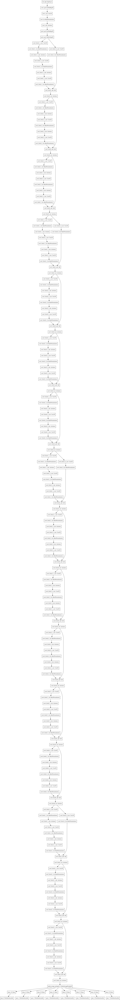

In [51]:
tf.keras.utils.plot_model(model,"./model.png")

In [41]:
train_history = model.fit(train_gen_,
                          epochs=20,
#                           validation_data=valid_gen_,
                          callbacks=[callback],# PrinterCallback()
                          #verbose=0
                          )

Epoch 1/20
90/90 [==============================] - 29s 232ms/step - loss: 16.0641 - gene_0_loss: 1.1050 - gene_1_loss: 0.7677 - gene_2_loss: 0.9078 - gene_3_loss: 1.7037 - gene_4_loss: 5.6643 - gene_5_loss: 2.4287 - gene_6_loss: 0.4704 - gene_7_loss: 3.0165
Epoch 2/20
90/90 [==============================] - 21s 230ms/step - loss: 10.4720 - gene_0_loss: 0.9674 - gene_1_loss: 0.5931 - gene_2_loss: 0.7852 - gene_3_loss: 1.3456 - gene_4_loss: 2.5705 - gene_5_loss: 1.8187 - gene_6_loss: 0.3832 - gene_7_loss: 2.0084
Epoch 3/20
90/90 [==============================] - 21s 230ms/step - loss: 9.9432 - gene_0_loss: 0.9371 - gene_1_loss: 0.5727 - gene_2_loss: 0.7541 - gene_3_loss: 1.2870 - gene_4_loss: 2.4314 - gene_5_loss: 1.7215 - gene_6_loss: 0.3636 - gene_7_loss: 1.8757
Epoch 4/20
90/90 [==============================] - 21s 231ms/step - loss: 9.6483 - gene_0_loss: 0.9183 - gene_1_loss: 0.5628 - gene_2_loss: 0.7385 - gene_3_loss: 1.2587 - gene_4_loss: 2.3360 - gene_5_loss: 1.6735 - gene_6_l

KeyError: 'val_loss'

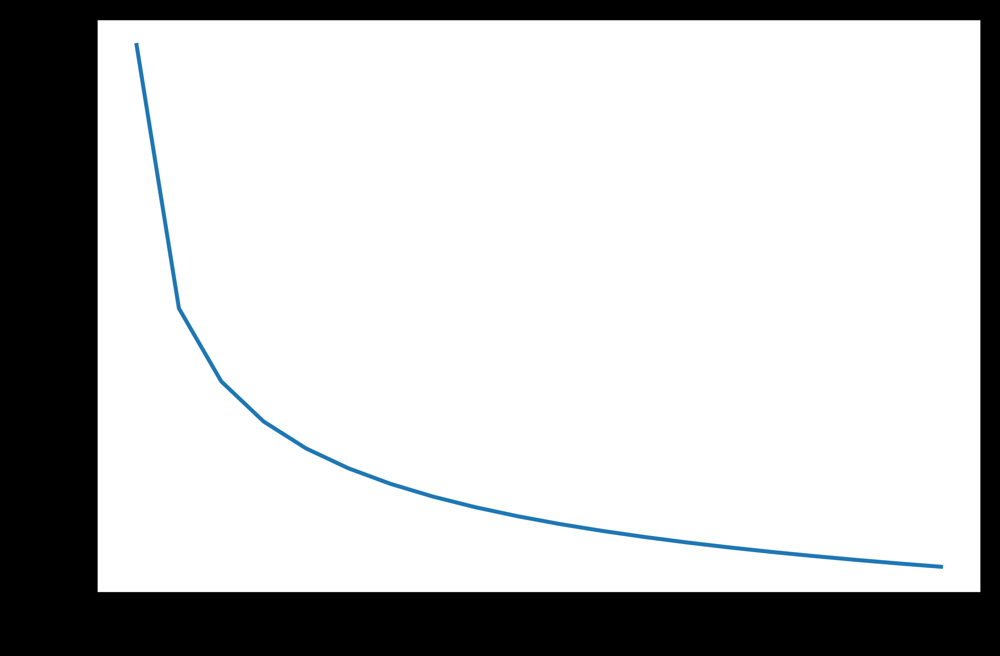

In [15]:
plt.plot(train_history.history['loss'])
plt.plot(train_history.history['val_loss'])
plt.legend(['loss', 'val_loss'])
plt.xlabel('Epochs')
plt.show()

In [42]:
test_predictions = model.predict(test_gen_)
# test_dataset.obsm["predicted_gene"] = test_predictions
# test_dataset.obsm["predicted_gene"] = np.array(test_predictions).transpose()

In [43]:
test_dataset.obsm["predicted_gene"] = np.array(test_predictions).transpose()

In [69]:
test_dataset.obsm["predicted_gene"] = np.array(test_predictions).reshape(8,-1).transpose()

In [18]:
# test_predictions = model.predict(test_gen_)
from scipy.stats import nbinom
y_preds=[]
for i in range(8):
    n = test_predictions[i][:,0]; p = test_predictions[i][:,1]
    y_pred = nbinom.mean(n,p)
    y_preds.append(y_pred)

test_dataset.obsm["predicted_gene"] = np.array(y_preds).transpose()

In [49]:
test_dataset_ = test_dataset[:,comm_genes].copy()
test_dataset_.X = test_dataset_.obsm["predicted_gene"]

SLITRK6


<ipython-input-48-b554f1a36fb9>:113: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


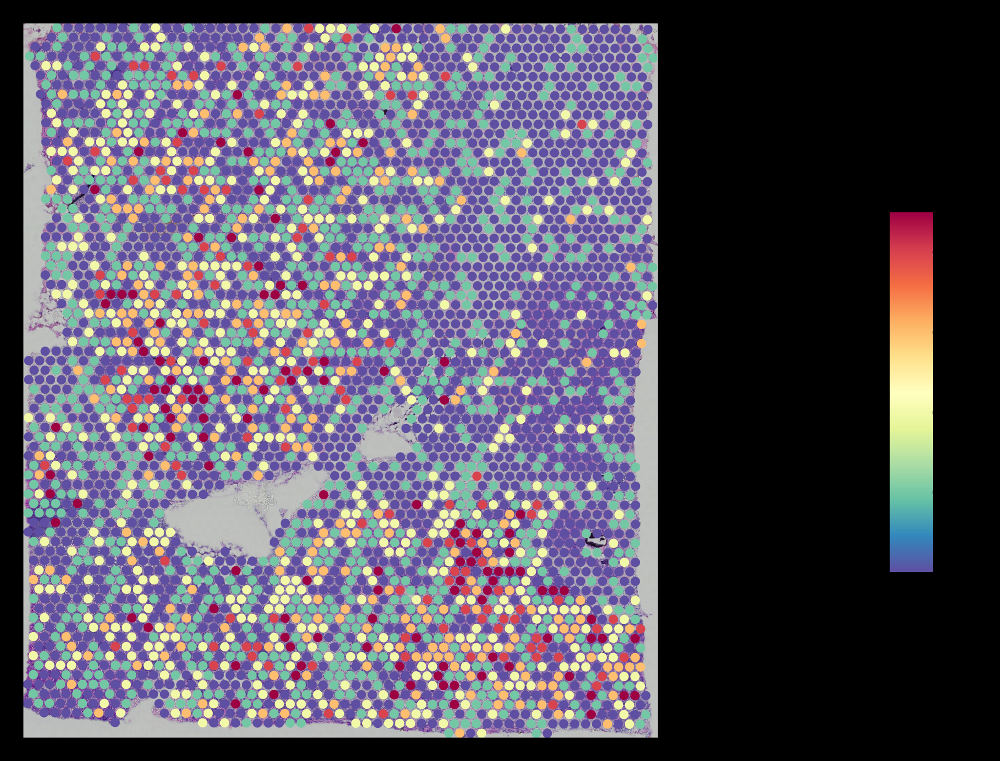

PGM5


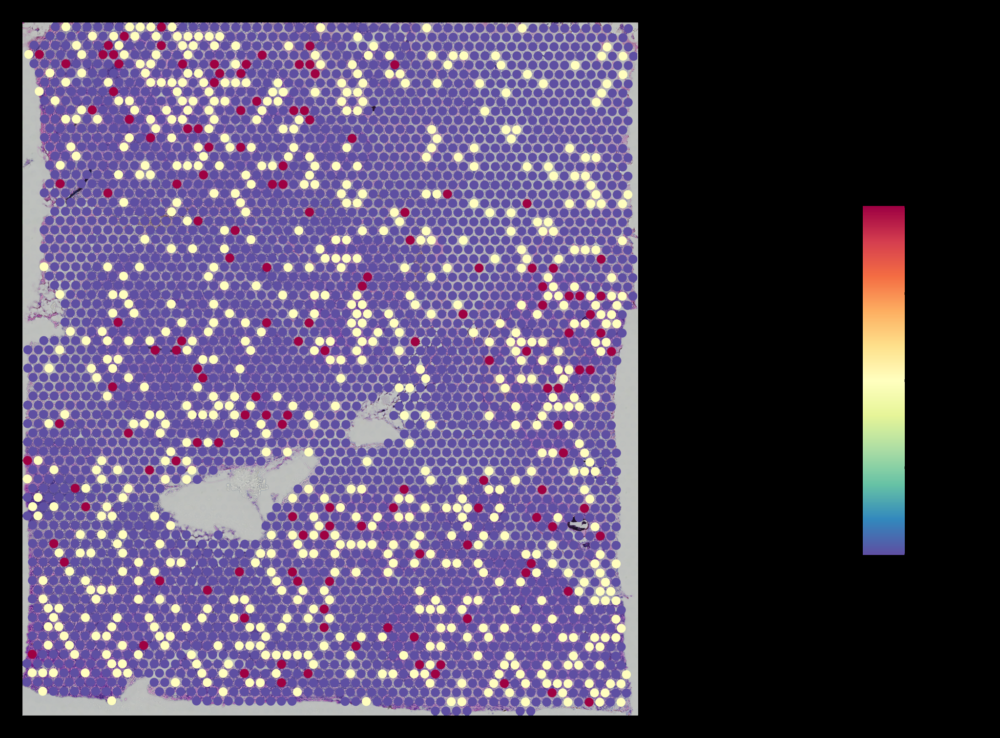

LINC00645


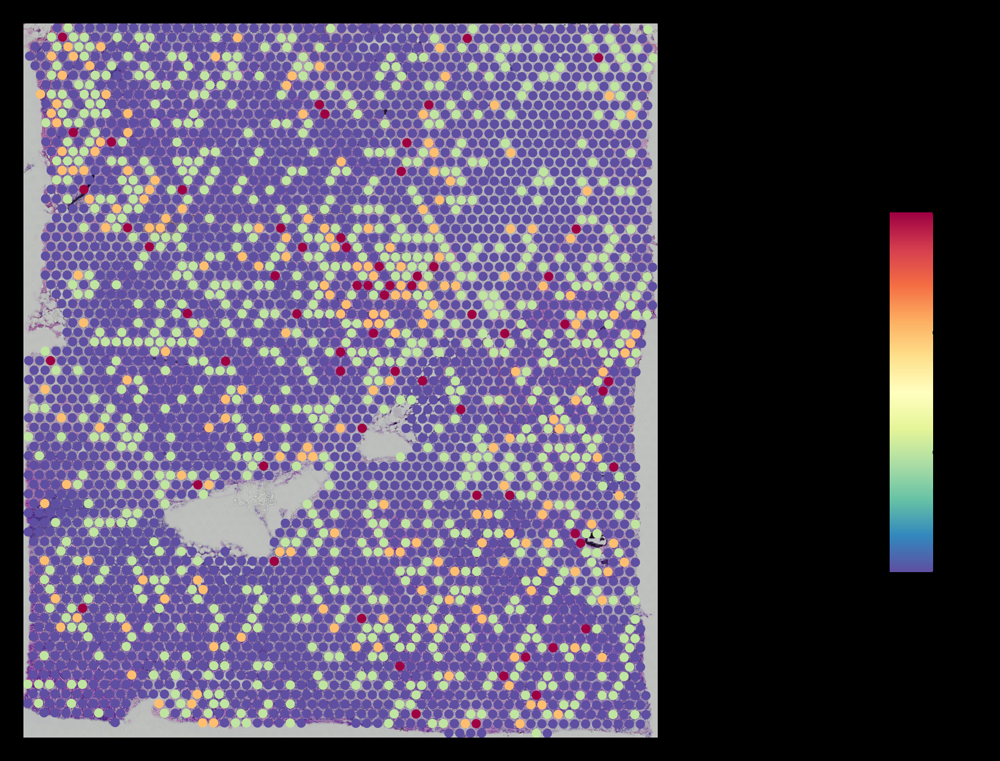

TTLL12


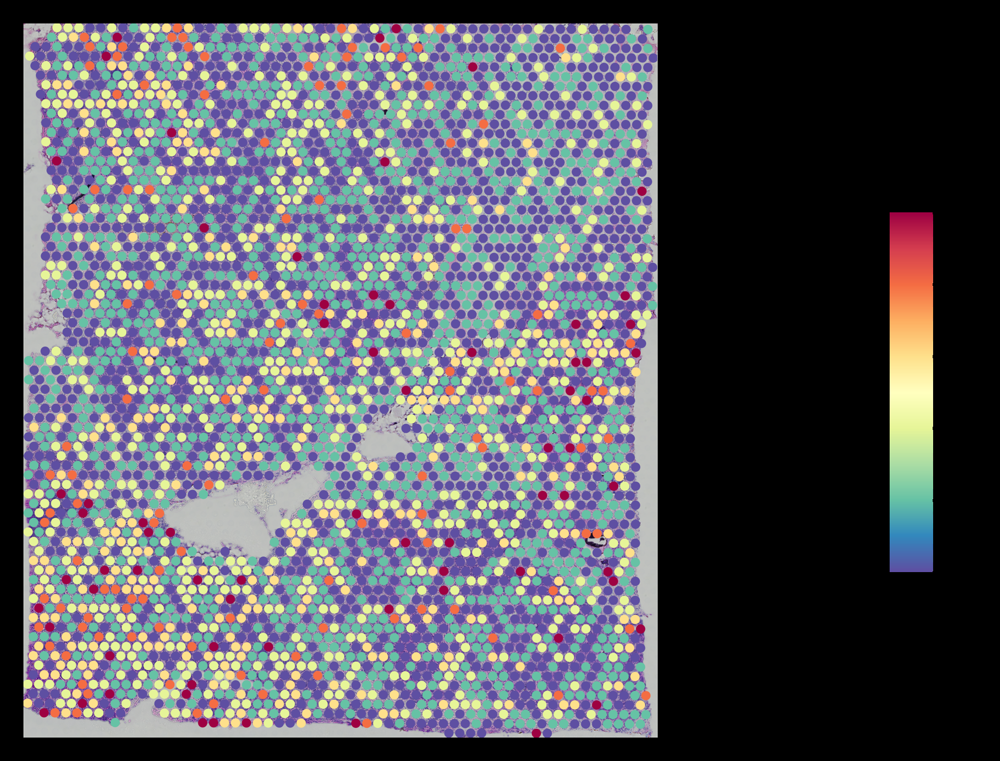

COX6C


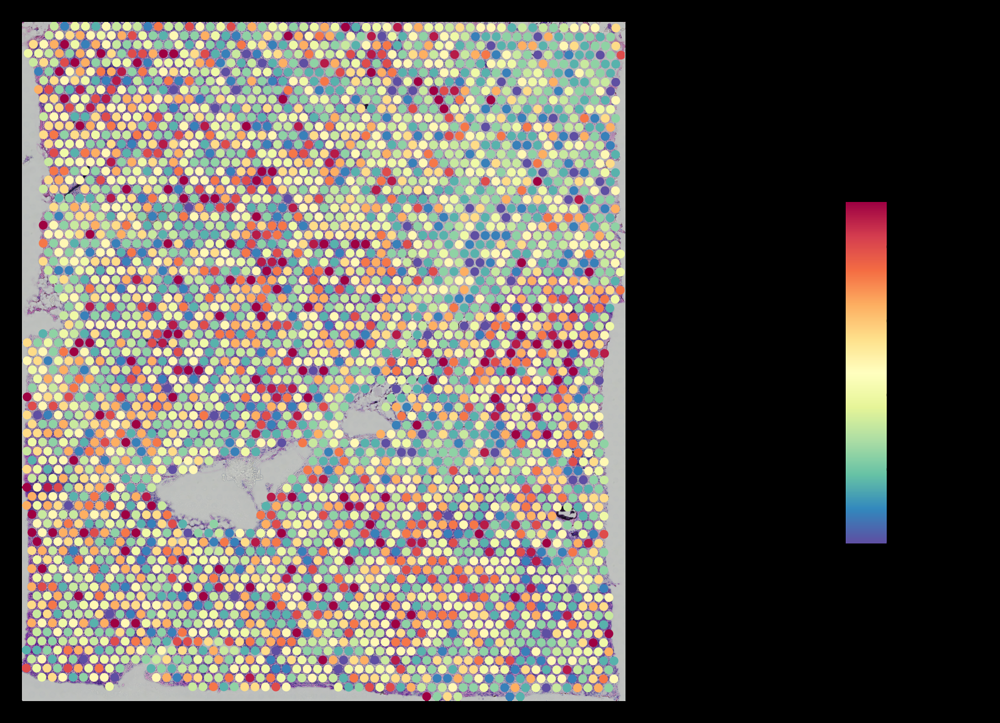

CPB1


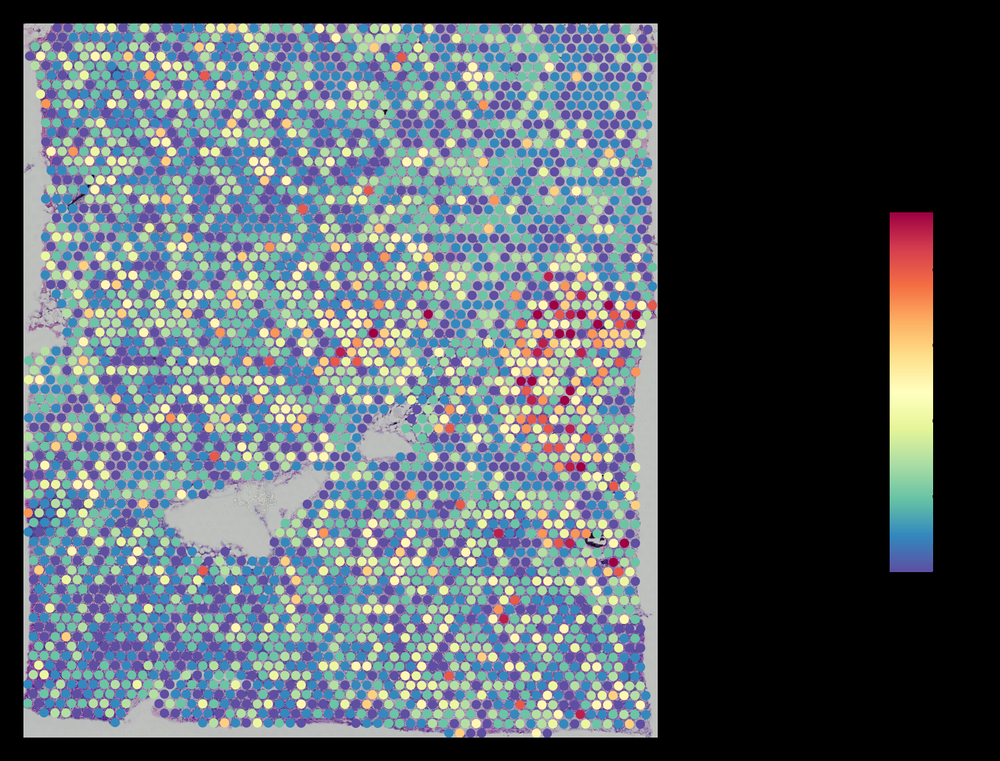

KRT5


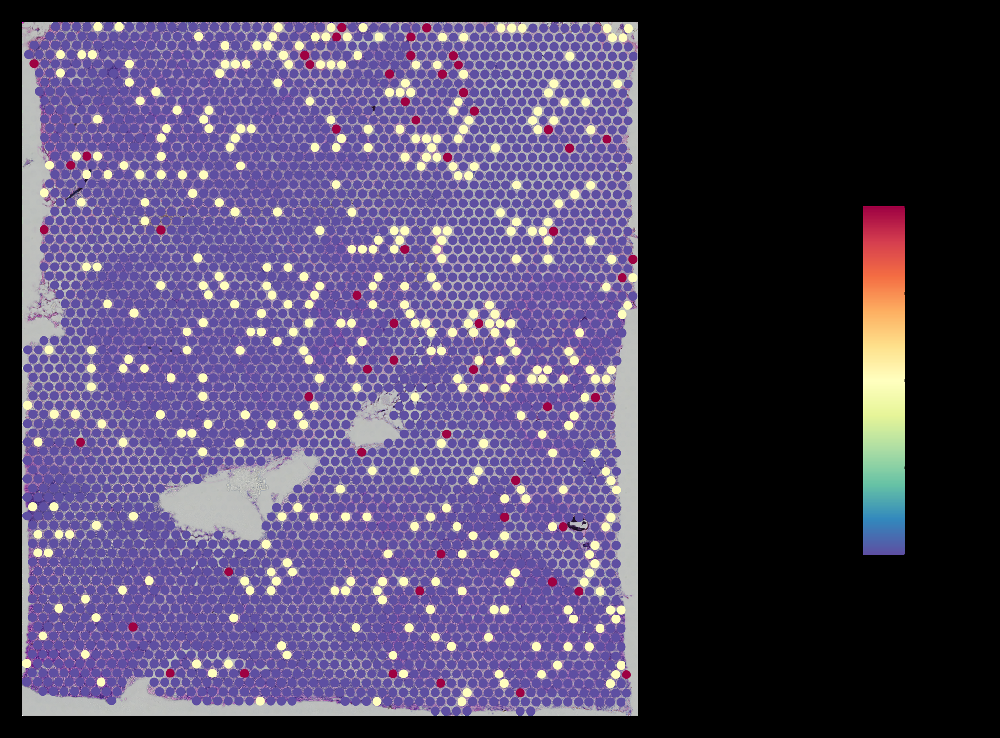

MALAT1


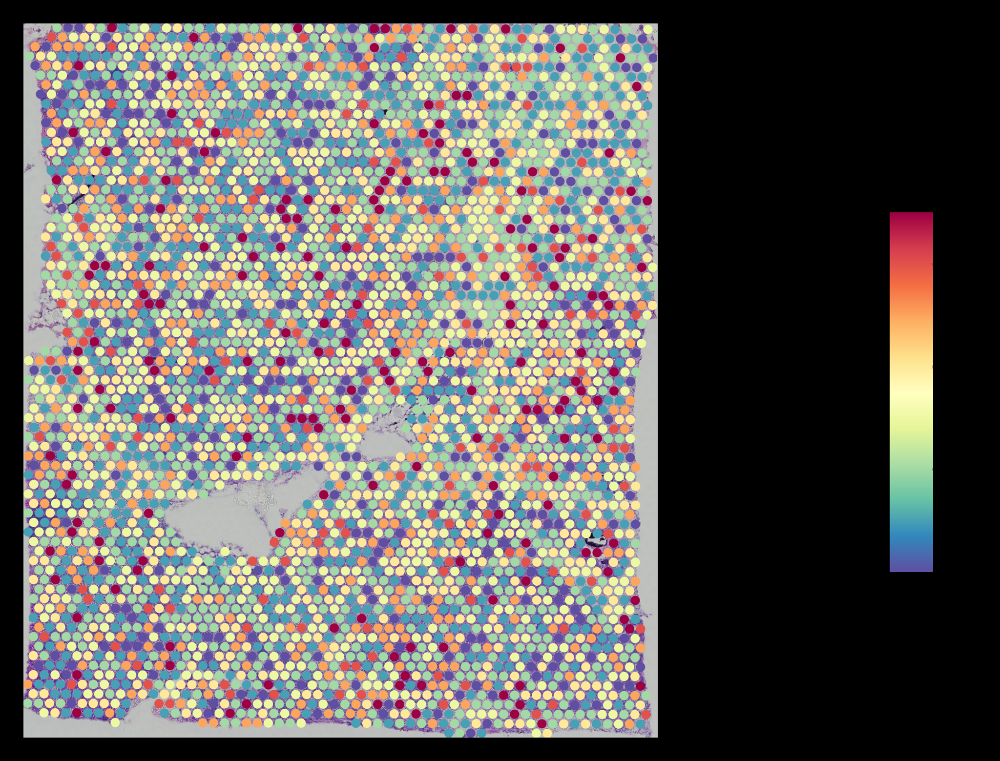

In [50]:
for gene in comm_genes:
    print(gene)
    gene_plot(test_dataset_, genes=gene, spot_size=8)

In [22]:
# for gene in comm_genes:
#     gene_plot(Sample2, genes=gene, spot_size=8)

In [48]:
from matplotlib import pyplot as plt
from PIL import Image
import pandas as pd
import matplotlib
import numpy as np

from stlearn._compat import Literal
from typing import Optional, Union
from anndata import AnnData
import warnings
#from .utils import get_img_from_fig, checkType


def gene_plot(
    adata: AnnData,
    method: str = "CumSum",
    genes: Optional[Union[str, list]] = None,
    threshold: float = None,
    library_id: str = None,
    data_alpha: float = 1.0,
    tissue_alpha: float = 1.0,
    vmin: float = None,
    vmax: float = None,
    cmap: str = "Spectral_r",
    spot_size: Union[float, int] = 6.5,
    show_legend: bool = False,
    show_color_bar: bool = True,
    show_axis: bool = False,
    cropped: bool = True,
    margin: int = 100,
    name: str = None,
    output: str = None,
    copy: bool = False,
) -> Optional[AnnData]:
    """\
    Gene expression plot for sptial transcriptomics data.
    Parameters
    ----------
    adata
        Annotated data matrix.
    library_id
        Library id stored in AnnData.
    method
        Use method to count. We prorive: NaiveMean, NaiveSum, CumSum.
    genes
        Choose a gene or a list of genes.
    threshold
        Threshold to filter genes
    data_alpha
        Opacity of the spot.
    tissue_alpha
        Opacity of the tissue.
    cmap
        Color map to use.
    spot_size
        Size of the spot.
    show_color_bar
        Show color bar or not.
    show_axis
        Show axis or not.
    show_legend
        Show legend or not.
    show_trajectory
        Show the spatial trajectory or not. It requires stlearn.spatial.trajectory.pseudotimespace.
    show_subcluster
        Show subcluster or not. It requires stlearn.spatial.trajectory.global_level.
    name
        Name of the output figure file.
    output
        Save the figure as file or not.
    copy
        Return a copy instead of writing to adata.
    Returns
    -------
    Nothing
    """

    #plt.rcParams['figure.dpi'] = dpi

    if type(genes) == str:
        genes = [genes]
    colors = _gene_plot(adata, method, genes)

    if threshold is not None:
        colors = colors[colors>threshold]

    index_filter = colors.index

    filter_obs  = adata.obs.loc[index_filter]

    imagecol = filter_obs["imagecol"]
    imagerow = filter_obs["imagerow"]
    
    # Option for turning off showing figure
    plt.ioff()

    # Initialize matplotlib
    fig, a = plt.subplots()
    if vmin:
        vmin=vmin
    else:
        vmin = min(colors)
    if vmax:
        vmax=vmax
    else:
        vmax = max(colors)/2
    # Plot scatter plot based on pixel of spots
    plot = a.scatter(imagecol, imagerow, edgecolor="none", alpha=data_alpha, s=spot_size, marker="o",
                     vmin=vmin, vmax=vmax, cmap=plt.get_cmap(cmap), c=colors)

    if show_color_bar:

        cb = plt.colorbar(plot, cax=fig.add_axes(
            [0.9, 0.3, 0.03, 0.38]), cmap=cmap)
        cb.outline.set_visible(False)

    if not show_axis:
        a.axis('off')

    if library_id is None:
        library_id = list(adata.uns["spatial"].keys())[0]

    image = adata.uns["spatial"][library_id]["images"][adata.uns["spatial"]["use_quality"]]
    # Overlay the tissue image
    a.imshow(image, alpha=tissue_alpha, zorder=-1,)

    if cropped:
        imagecol = adata.obs["imagecol"]
        imagerow = adata.obs["imagerow"]

        a.set_xlim(imagecol.min() - margin,
                imagecol.max() + margin)

        a.set_ylim(imagerow.min() - margin,
                imagerow.max() + margin)
        
        a.set_ylim(a.get_ylim()[::-1])

    if name is None:
        name = method
    if output is not None:
        fig.savefig(output + "/" + name, dpi=plt.figure().dpi,
                    bbox_inches='tight', pad_inches=0)
        
    


    plt.show()



def _gene_plot(adata, method, genes):

    # Gene plot option

    if len(genes) == 0:
        raise ValueError('Genes shoule be provided, please input genes')

    elif len(genes) == 1:

        if genes[0] not in adata.var.index:
            raise ValueError(
                genes[0] + ' is not exist in the data, please try another gene')

        colors = adata[:, genes].to_df().iloc[:, -1]

        return colors
    else:

        for gene in genes:
            if gene not in adata.var.index:
                genes.remove(gene)
                warnings.warn("We removed " + gene +
                              " because they not exist in the data")

            if len(genes) == 0:
                raise ValueError(
                    'All provided genes are not exist in the data')

        count_gene = adata[:, genes].to_df()

        if method is None:
            raise ValueError(
                'Please provide method to combine genes by NaiveMean/NaiveSum/CumSum')

        if method == "NaiveMean":
            present_genes = (count_gene > 0).sum(axis=1) / len(genes)

            count_gene = (count_gene.mean(axis=1)) * present_genes
        elif method == "NaiveSum":
            present_genes = (count_gene > 0).sum(axis=1) / len(genes)

            count_gene = (count_gene.sum(axis=1)) * present_genes

        elif method == "CumSum":
            count_gene = count_gene.cumsum(axis=1).iloc[:, -1]

        colors = count_gene

        return colors

